# Image processing

## 1st Assignment - Shahid Beheshti University 

### Outline
- [Question 1](#0)
- [Question 2](#1)

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from skimage import io
from sklearn.cluster import KMeans
import numpy as np
import warnings
warnings.filterwarnings("ignore")

<a name="0"></a>
## Question 1
#### Face Detection and Image Transformations With OpenCV

In [2]:
# Load the cascade
face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')

In [3]:
# Read the input image
img = cv2.imread('images/image1.jpg')

In [4]:
img

array([[[140, 126, 108],
        [141, 127, 109],
        [142, 127, 111],
        ...,
        [ 23,  19,  14],
        [ 22,  18,  13],
        [ 22,  18,  13]],

       [[140, 126, 108],
        [140, 126, 108],
        [141, 126, 110],
        ...,
        [ 23,  19,  14],
        [ 23,  19,  14],
        [ 22,  18,  13]],

       [[139, 125, 107],
        [140, 126, 108],
        [142, 126, 110],
        ...,
        [ 23,  19,  14],
        [ 23,  19,  14],
        [ 23,  19,  14]],

       ...,

       [[ 45,  56,  83],
        [ 49,  64,  90],
        [ 51,  75, 103],
        ...,
        [208, 208, 208],
        [209, 209, 209],
        [209, 209, 209]],

       [[ 44,  51,  76],
        [ 47,  58,  85],
        [ 49,  70,  98],
        ...,
        [207, 207, 207],
        [208, 208, 208],
        [209, 209, 209]],

       [[ 43,  47,  71],
        [ 45,  55,  79],
        [ 48,  67,  94],
        ...,
        [206, 206, 206],
        [207, 207, 207],
        [209, 209, 209]]

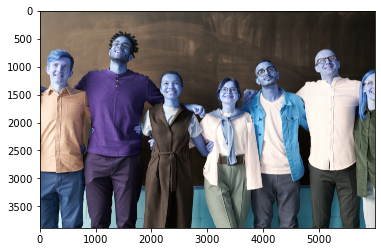

In [5]:
plt.imshow(img)

In [6]:
# Convert into grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

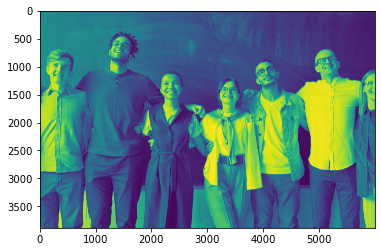

In [7]:
plt.imshow(gray)

## Face Detection

In [8]:
face = img.copy()
img = cv2.imread('images/image1.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
faces2 = face_cascade.detectMultiScale(
gray,
scaleFactor=1.1,
minNeighbors=5,
minSize=(300, 300),
flags=cv2.CASCADE_SCALE_IMAGE)

In [9]:
# Draw rectangle around the faces
for (x, y, w, h) in faces2:
    cv2.rectangle(face, (x, y), (x+w, y+h), (0, 255, 0), 10)

In [10]:
cv2.namedWindow('test',cv2.WINDOW_NORMAL)
cv2.resizeWindow('test', 600,600)
cv2.imshow('test',img)
cv2.waitKey(0)
cv2.destroyAllWindows()

### Result

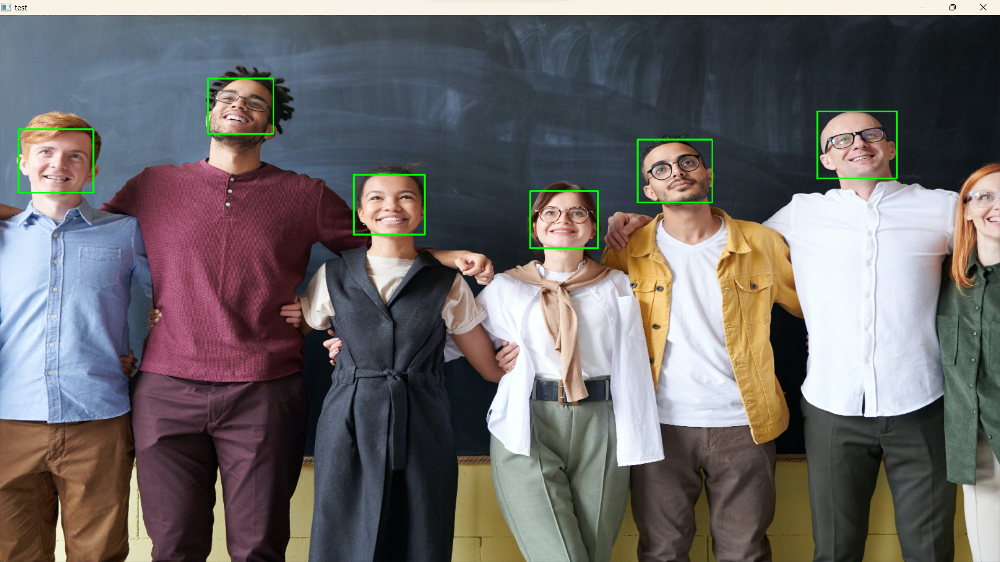

## Transform image

### Rotation 

In [11]:
ROTATE_90_CLOCKWISE = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    transformed_face = cv2.rotate(face_region, cv2.ROTATE_90_CLOCKWISE)
    ROTATE_90_CLOCKWISE[y:y+h, x:x+w] = transformed_face

In [12]:
ROTATE_90_COUNTERCLOCKWISE = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    transformed_face = cv2.rotate(face_region, cv2.ROTATE_90_COUNTERCLOCKWISE)
    ROTATE_90_COUNTERCLOCKWISE[y:y+h, x:x+w] = transformed_face

In [13]:
ROTATE_180 = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    transformed_face = cv2.rotate(face_region, cv2.ROTATE_180)
    ROTATE_180[y:y+h, x:x+w] = transformed_face

In [14]:
mirror = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    num_rows, num_cols = face_region.shape[:2]
    
    src_points = np.float32([[0,0], [num_cols-1,0], [0,num_rows-1]])
    dst_points = np.float32([[num_cols-1,0], [0,0], [num_cols-1,num_rows-1]])
    matrix = cv2.getAffineTransform(src_points, dst_points)
    face_region = cv2.warpAffine(face_region, matrix, (num_cols,num_rows))

    mirror[y:y+h, x:x+w] = face_region

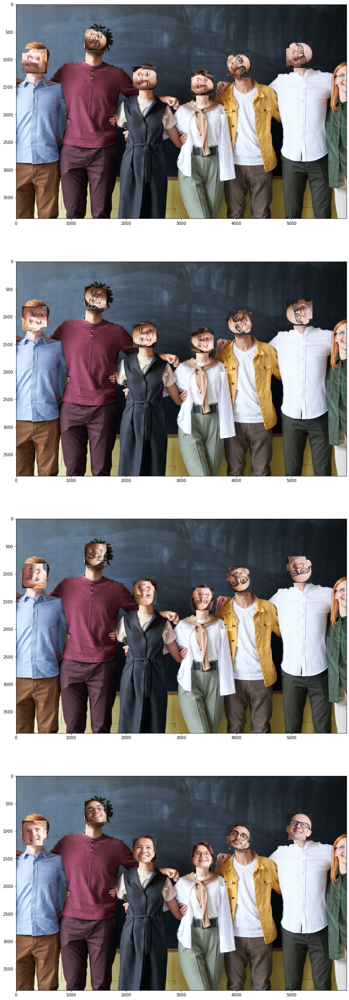

In [16]:
fig, ax = plt.subplots(4, 1, figsize=(20, 45))
ax[0].imshow(cv2.cvtColor(ROTATE_90_CLOCKWISE, cv2.COLOR_BGR2RGB))
ax[1].imshow(cv2.cvtColor(ROTATE_90_COUNTERCLOCKWISE, cv2.COLOR_BGR2RGB))
ax[2].imshow(cv2.cvtColor(ROTATE_180, cv2.COLOR_BGR2RGB))
ax[3].imshow(cv2.cvtColor(mirror, cv2.COLOR_BGR2RGB))

## Change pixel values

In [17]:
ten = img.copy()
for (x,y,w,h) in faces2:
    # Extract the face region from the color image
    face_region = img[y:y+h, x:x+w]
    face_region = face_region * 10
    ten[y:y+h, x:x+w] = face_region

In [19]:
twenty= img.copy()
for (x,y,w,h) in faces2:
    # Extract the face region from the color image
    face_region = img[y:y+h, x:x+w]
    face_region = face_region * 20
    twenty[y:y+h, x:x+w] = face_region

In [20]:
thirty = img.copy()
for (x,y,w,h) in faces2:
    # Extract the face region from the color image
    face_region = img[y:y+h, x:x+w]
    face_region = face_region * 30
    thirty[y:y+h, x:x+w] = face_region

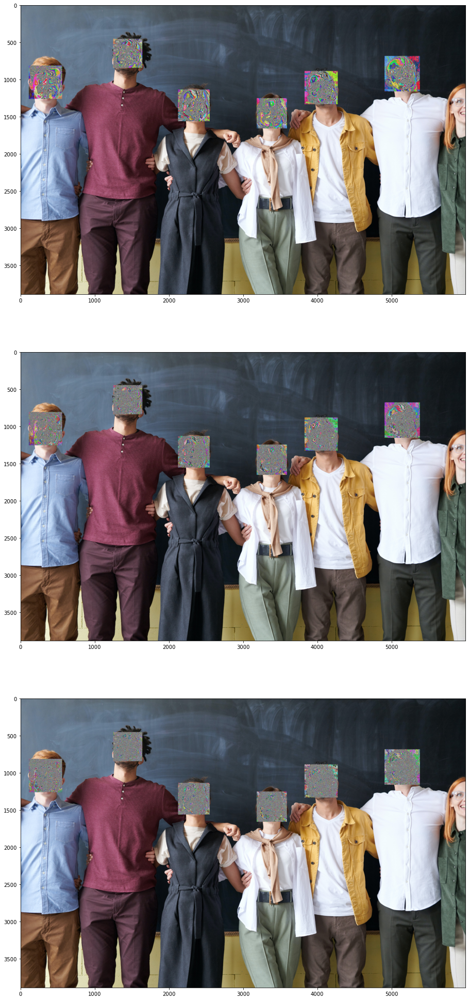

In [21]:
fig, ax = plt.subplots(3, 1, figsize=(20, 35))
ax[0].imshow(cv2.cvtColor(ten, cv2.COLOR_BGR2RGB))
ax[1].imshow(cv2.cvtColor(twenty, cv2.COLOR_BGR2RGB))
ax[2].imshow(cv2.cvtColor(thirty, cv2.COLOR_BGR2RGB))

# 

In [22]:
fiveDivide = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    face_region = face_region / 5
    fiveDivide[y:y+h, x:x+w] = face_region
tenDivide = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    face_region = face_region / 10
    tenDivide[y:y+h, x:x+w] = face_region
    
thirtyDivide = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    face_region = face_region / 30
    thirtyDivide[y:y+h, x:x+w] = face_region

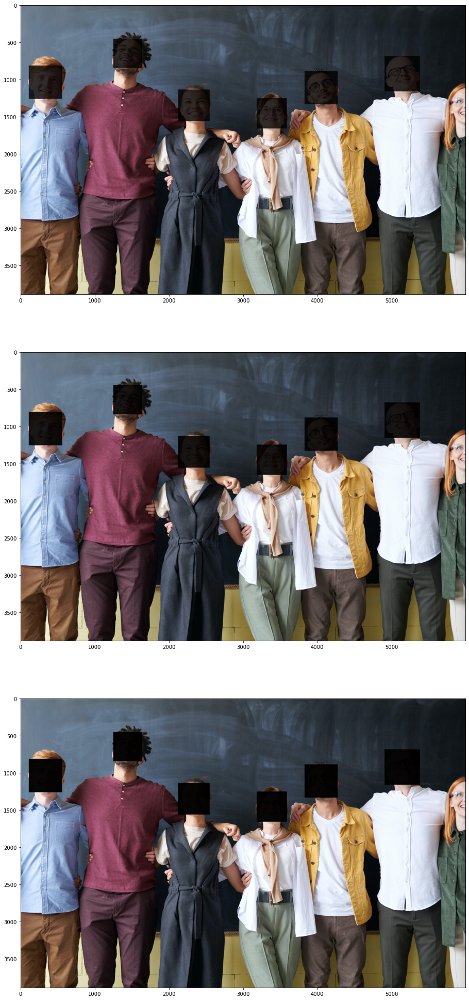

In [23]:
fig, ax = plt.subplots(3, 1, figsize=(20, 35))
ax[0].imshow(cv2.cvtColor(fiveDivide, cv2.COLOR_BGR2RGB))
ax[1].imshow(cv2.cvtColor(tenDivide, cv2.COLOR_BGR2RGB))
ax[2].imshow(cv2.cvtColor(thirtyDivide, cv2.COLOR_BGR2RGB))

In [24]:
sqrt = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    face_region = np.sqrt(face_region)
    sqrt[y:y+h, x:x+w] = face_region
    
linear = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    face_region = face_region*15 + 10
    linear[y:y+h, x:x+w] = face_region
    
nonlinear2 = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    face_region = face_region**2 
    nonlinear2[y:y+h, x:x+w] = face_region

nonlinear3 = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    face_region = face_region**3 
    nonlinear3[y:y+h, x:x+w] = face_region
    
log = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    face_region = np.log(face_region, where=(face_region!=0))
    log[y:y+h, x:x+w] = face_region

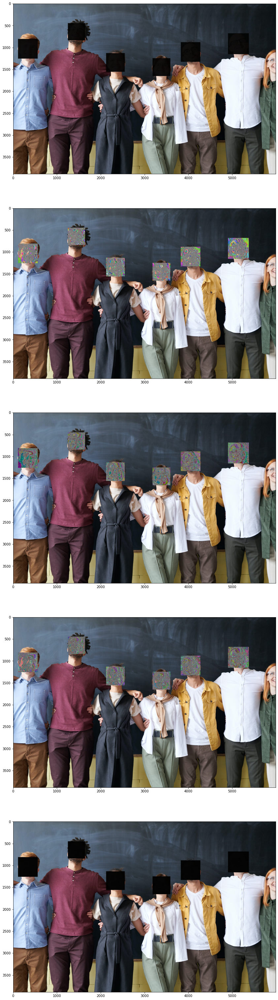

In [25]:
fig, ax = plt.subplots(5, 1, figsize=(20, 55))
ax[0].imshow(cv2.cvtColor(sqrt, cv2.COLOR_BGR2RGB))
ax[1].imshow(cv2.cvtColor(linear, cv2.COLOR_BGR2RGB))
ax[2].imshow(cv2.cvtColor(nonlinear2, cv2.COLOR_BGR2RGB))
ax[3].imshow(cv2.cvtColor(nonlinear3, cv2.COLOR_BGR2RGB))
ax[4].imshow(cv2.cvtColor(log, cv2.COLOR_BGR2RGB))

### Translation 

In [26]:
translation1 = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    num_rows, num_cols = face_region.shape[:2]
    translation_matrix = np.float32([ [1,0,-30], [0,1,-50] ])
    img_translation = cv2.warpAffine(face_region, translation_matrix, (num_cols, num_rows), cv2.INTER_LINEAR)
    translation1[y:y+h, x:x+w] = img_translation

In [27]:
translation2 = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    num_rows, num_cols = face_region.shape[:2]
    translation_matrix = np.float32([ [1,0,70], [0,1,110] ])
    img_translation = cv2.warpAffine(face_region, translation_matrix, (num_cols, num_rows), cv2.INTER_LINEAR)
    translation2[y:y+h, x:x+w] = img_translation

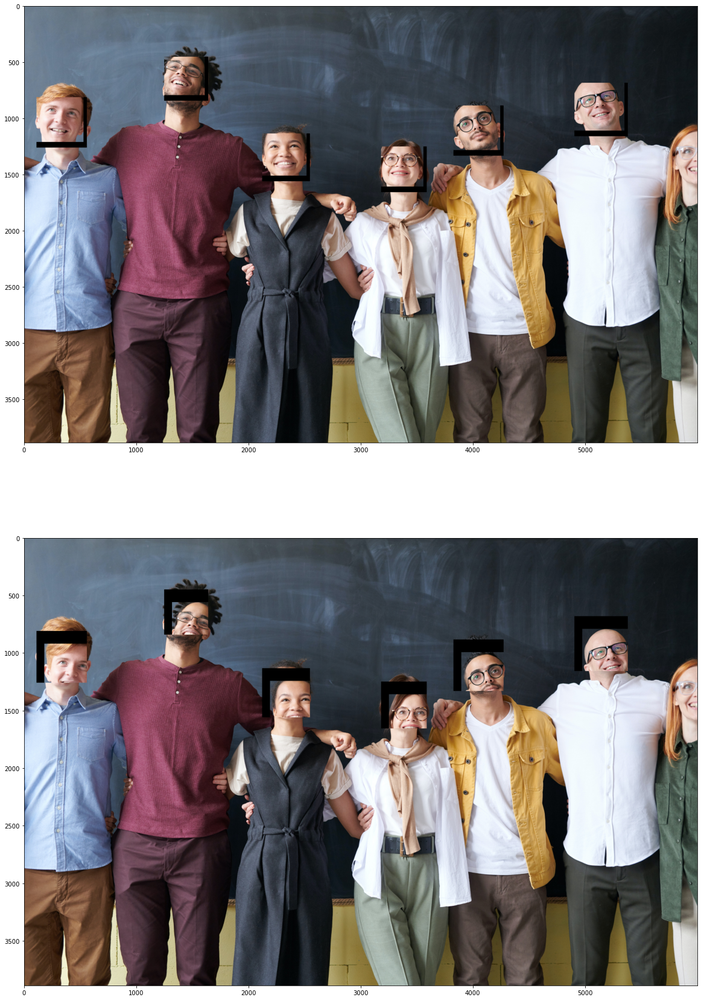

In [28]:
fig, ax = plt.subplots(2, 1, figsize=(20, 30))
ax[0].imshow(cv2.cvtColor(translation1, cv2.COLOR_BGR2RGB))
ax[1].imshow(cv2.cvtColor(translation2, cv2.COLOR_BGR2RGB), aspect='auto')

### Image Transformation

In [29]:
Affine  = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    num_rows, num_cols = face_region.shape[:2]
    src_points = np.float32([[0,0], [num_cols-1,0], [0,num_rows-1]])
    dst_points = np.float32([[0,0], [int(0.6*(num_cols-1)),0], [int(0.4*(num_cols-1)),num_rows-1]])
    matrix = cv2.getAffineTransform(src_points, dst_points)
    face_region = cv2.warpAffine(face_region, matrix, (num_cols,num_rows))
    Affine [y:y+h, x:x+w] = face_region

In [30]:
Projective = img.copy()
for (x,y,w,h) in faces2:
    face_region = img[y:y+h, x:x+w]
    num_rows, num_cols = face_region.shape[:2]
    src_points = np.float32([[0,0], [num_cols-1,0], [0,num_rows-1], [num_cols-1,num_rows-1]])
    dst_points = np.float32([[0,0], [num_cols-1,0], [int(0.33*num_cols),num_rows-1], [int(0.66*num_cols),num_rows-1]])    
    projective_matrix = cv2.getPerspectiveTransform(src_points, dst_points)
    face_region = cv2.warpPerspective(face_region, projective_matrix, (num_cols,num_rows))
    Projective [y:y+h, x:x+w] = face_region

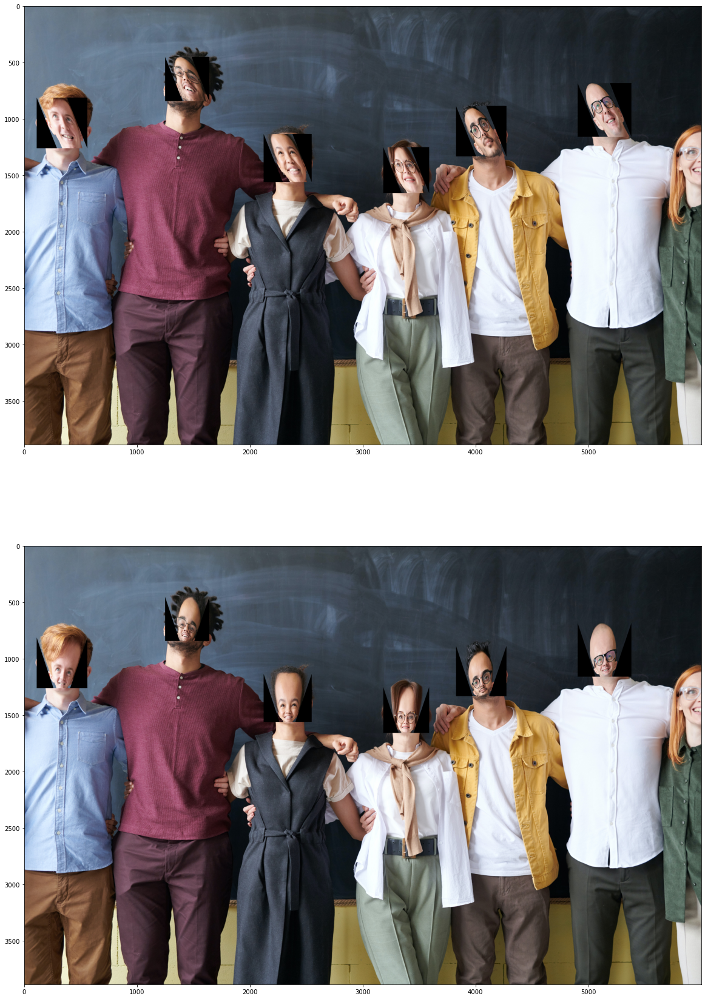

In [31]:
fig, ax = plt.subplots(2, 1, figsize=(20, 30))
ax[0].imshow(cv2.cvtColor(Affine, cv2.COLOR_BGR2RGB))
ax[1].imshow(cv2.cvtColor(Projective, cv2.COLOR_BGR2RGB))

# 

<a name="1"></a>
## Question 2
#### Image Compression using K-Means Clustering

In [32]:
# Read the input image
img2 = cv2.imread('images/image2.jpg')

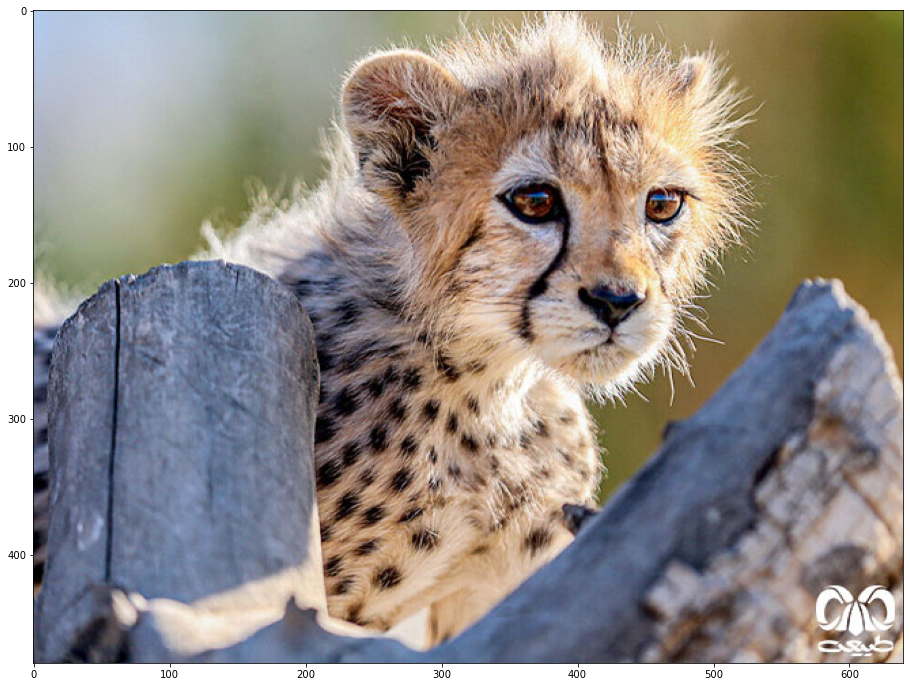

In [33]:
fig, ax = plt.subplots(1, 1, figsize=(20, 12))
plt.imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))

In [34]:
def compressed(image,k):
    rows = image.shape[0]
    cols = image.shape[1]
    #Flatten the image
    image = image.reshape(rows*cols, 3)
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(image)

    #Replace each pixel value with its nearby centroid
    compressed_image = kmeans.cluster_centers_[kmeans.labels_]
    compressed_image = np.clip(compressed_image.astype('uint8'), 0, 255)

    #Reshape the image to original dimension
    compressed_image = compressed_image.reshape(rows, cols, 3)
    return compressed_image

Text(0.5, 1.0, 'K =  128')

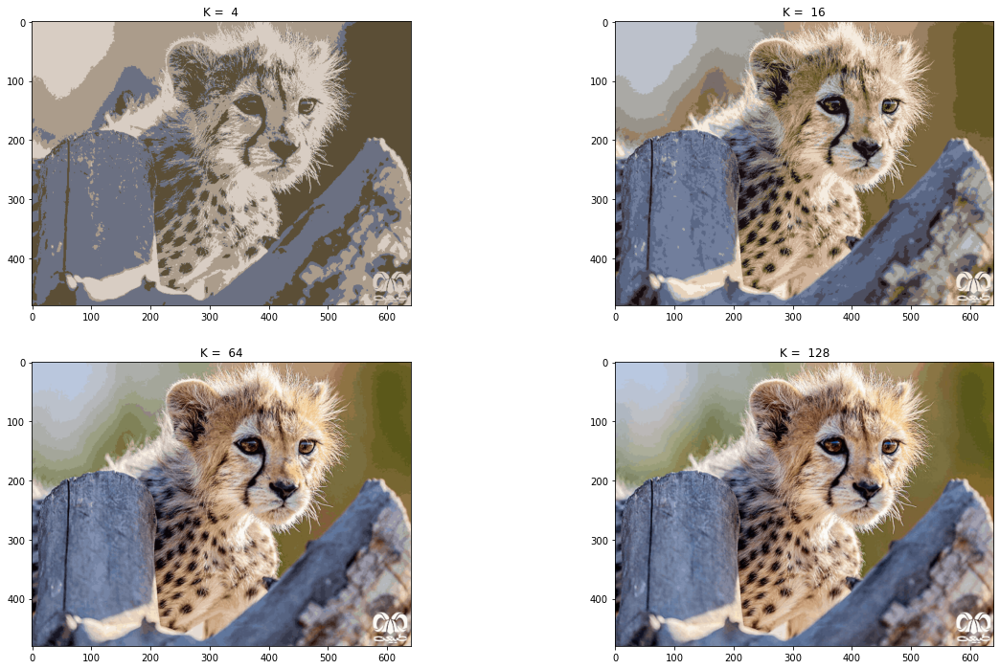

In [35]:
fig, ax = plt.subplots(2, 2, figsize=(20, 12))
ax[0][0].imshow(cv2.cvtColor(compressed(img2,4) , cv2.COLOR_BGR2RGB))
ax[0][0].set_title("K =  4")
ax[0][1].imshow(cv2.cvtColor(compressed(img2,16), cv2.COLOR_BGR2RGB))
ax[0][1].set_title("K =  16")
ax[1][0].imshow(cv2.cvtColor(compressed(img2,64), cv2.COLOR_BGR2RGB))
ax[1][0].set_title("K =  64")
ax[1][1].imshow(cv2.cvtColor(compressed(img2,128), cv2.COLOR_BGR2RGB))
ax[1][1].set_title("K =  128")

# 

In [36]:
HSV = cv2.cvtColor(img2, cv2.COLOR_RGB2HSV)
LAB = cv2.cvtColor(img2, cv2.COLOR_RGB2LAB)
YUV = cv2.cvtColor(img2, cv2.COLOR_RGB2YUV)
YCrCb = cv2.cvtColor(img2, cv2.COLOR_RGB2YCrCb)
XYZ = cv2.cvtColor(img2, cv2.COLOR_RGB2XYZ)

Text(0.5, 1.0, 'K=4')

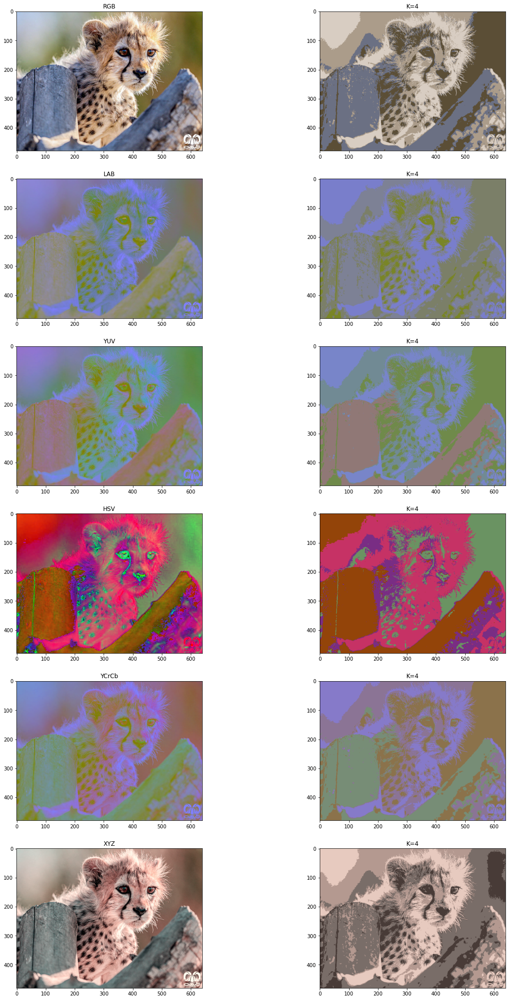

In [37]:
#K = 4 
fig, ax = plt.subplots(6, 2, figsize=(20, 36))

ax[0][0].imshow(cv2.cvtColor(img2 , cv2.COLOR_BGR2RGB))
ax[0][0].set_title("RGB")
ax[0][1].imshow(cv2.cvtColor(compressed(img2,4), cv2.COLOR_BGR2RGB))
ax[0][1].set_title("K=4")

ax[1][0].imshow(cv2.cvtColor(LAB, cv2.COLOR_BGR2RGB))
ax[1][0].set_title("LAB")
ax[1][1].imshow(cv2.cvtColor(compressed(LAB,4), cv2.COLOR_BGR2RGB))
ax[1][1].set_title("K=4")

ax[2][0].imshow(cv2.cvtColor(YUV, cv2.COLOR_BGR2RGB))
ax[2][0].set_title("YUV")
ax[2][1].imshow(cv2.cvtColor(compressed(YUV,4), cv2.COLOR_BGR2RGB))
ax[2][1].set_title("K=4")

ax[3][0].imshow(cv2.cvtColor(HSV, cv2.COLOR_BGR2RGB))
ax[3][0].set_title("HSV")
ax[3][1].imshow(cv2.cvtColor(compressed(HSV,4), cv2.COLOR_BGR2RGB))
ax[3][1].set_title("K=4")

ax[4][0].imshow(cv2.cvtColor(YCrCb, cv2.COLOR_BGR2RGB))
ax[4][0].set_title("YCrCb")
ax[4][1].imshow(cv2.cvtColor(compressed(YCrCb,4), cv2.COLOR_BGR2RGB))
ax[4][1].set_title("K=4")

ax[5][0].imshow(cv2.cvtColor(XYZ, cv2.COLOR_BGR2RGB))
ax[5][0].set_title("XYZ")
ax[5][1].imshow(cv2.cvtColor(compressed(XYZ,4), cv2.COLOR_BGR2RGB))
ax[5][1].set_title("K=4")